<a href="https://colab.research.google.com/github/sharmarahulraj03/NLP_Tasks/blob/main/Assignment_1__DTI5125_Rahul_Raj_Sharma.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<H1 align="center"><b>Data Science Applications</b></H1>
<H5 align="left"><b><u> Overview:</u></b></H5>
<p align="justify">This assignment covers some basic data science tasks: exploratory data analysis, text pre-processing or wrangling,
and feature engineering. The assignment should be completed individually using either Python or R. You are
provided an unstructured movie review text data (in tsv format). Use applicable strategies discussed in class to
transform the text into information-rich features. Upon completion, present your result in one submission, including
the answers generated or plots. Also, submit the source codes used to generate your results as a separate attachment.
The assignment is in three parts; the first part involves using a wide variety of techniques to prepare the given text
data for analysis. The second part involves using various techniques to explore the data and the third part requires
the application of feature engineering methods to convert the text data to numeric data.</p>
<H5 align="left"><b><u>Part A: Data preprocessing (70 points)</u></b></H5>

<p align="justify">You are required to write codes or functions to complete the following preprocessing tasks required for removing
unnecessary information from the raw text data.
<ol>
<li>Load the data and clean the text data to remove unnecessary tag elements, punctuations, etc., to improve computational efficiency using applicable Python library (10 points)</li>
<li>Standardize the text data to expand contractions (5 points)</li>
<li>Convert the text data to lower case in order to have all the data in a uniform format (5 points)</li>
<li>Split the sentences into tokens using any tokenizer of your choice (10 points)</li>
<li>Remove stop words, a necessary step to remove commonly used words and retain key words (10 points)</li>
<li>Convert the tokenized words into their root forms using stemming or lemmatization technique (10 points)</li>
<li>Tag the parts of speech (10 points)</li>
<li>Build a shallow parse tree or a dependency parse tree for the text data (10 points)</li>
</ol></p>

<b>Importing required Libraries.</b>

In [ ]:
pip install contractions

     |████████████████████████████████| 266kB 5.4MB/s 
     |████████████████████████████████| 327kB 6.2MB/s 
  Created wheel for pyahocorasick: filename=pyahocorasick-1.4.1-cp36-cp36m-linux_x86_64.whl size=84340 sha256=d818c56a16a71cd87cd874d8a88f9bbec048dc7b35ef1c4dd77e6c1dd926ac0b
  Stored in directory: /root/.cache/pip/wheels/e4/ab/f7/cb39270df8f6126f3dd4c33d302357167086db460968cfc80c
Successfully built pyahocorasick


In [ ]:
!pip install wordcloud

In [ ]:
!pip install spacy 

In [ ]:
!pip install autocorrect

     |████████████████████████████████| 624kB 5.1MB/s 
  Created wheel for autocorrect: filename=autocorrect-2.3.0-cp36-none-any.whl size=621588 sha256=d83de6b36d052c7d3de954ab3695b9d5c123be1c8d237b5d86b4ffd6dc548aef
  Stored in directory: /root/.cache/pip/wheels/cc/1c/30/6b0199afbd20eef5959f5eaa0ead86aeef84391740482b2279
Successfully built autocorrect


In [ ]:
import nltk
import pandas as pd
import numpy as np
import csv
import re
import contractions
import string
import spacy
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.tokenize import word_tokenize

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

from nltk.corpus import stopwords
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
from spacy import displacy
from spacy.lang.en import English
from collections import Counter  
from wordcloud import WordCloud
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


**1. Load the data and clean the text data to remove unnecessary tag elements, punctuations, etc., to improve computational efficiency using applicable Python library (10 points)**

In [ ]:
# tell pandas to ignore quotes when text contains quotes & clean out quotes after loading into Dataframe
reviews = pd.read_csv('movie_review.tsv', header=0, delimiter="\t", quoting=csv.QUOTE_NONE)
reviews.head(10)

,id,review
0,"""9999_0""","""Watching Time Chasers, it obvious that it was..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B..."
3,"""7161_0""","""I went to see this film with a great deal of ..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ..."
5,"""36495_0""","""Jennifer Ehle was sparkling in \""Pride and Pr..."
6,"""49472_0""","""Amy Poehler is a terrific comedian on Saturda..."
7,"""36693_0""","""A plane carrying employees of a large biotech..."
8,"""316_0""","""A well made, gritty science fiction movie, it..."
9,"""32454_0""","""Incredibly dumb and utterly predictable story..."


In [ ]:
print(reviews['review'])

0        "Watching Time Chasers, it obvious that it was...
1        "I saw this film about 20 years ago and rememb...
2        "Minor Spoilers<br /><br />In New York, Joan B...
3        "I went to see this film with a great deal of ...
4        "Yes, I agree with everyone on this site this ...
                               ...                        
49995    "The original Man Eater by Joe D'Amato is some...
49996    "When Home Box Office was in it's early days m...
49997    "Griffin Dunne was born into a cultural family...
49998    "Not a bad story, but the low budget rears its...
49999    "This not-very-good mummy-alien flick does fea...
Name: review, Length: 50000, dtype: object


In [ ]:
#Cleaning HTML Tags
def Clean_html_text(raw_html):
  cleanr = re.compile('<.*?>')
  html_free_review = re.sub(cleanr,' ',raw_html)
  return html_free_review

reviews['without_html_tags']=reviews['review'].apply(lambda cw : Clean_html_text(cw))
reviews.head()

,id,review,without_html_tags
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ..."


In [ ]:
# Removing punctuations in string except "." because we need to do sentence tokenizing in further steps
# Using regex 
def Clean_punctuations(string):
  result = re.sub('[^a-zA-Z :\.]','',string) 
  return result

reviews['without_punctuations']=reviews['without_html_tags'].apply(lambda cw : Clean_punctuations(cw))
reviews.head()

,id,review,without_html_tags,without_punctuations
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...


**2. Standardize the text data to expand contractions (5 points)**

In [ ]:
#Standardization / Contraction of the data
reviews['without_contraction'] = reviews['without_punctuations'].apply(lambda x: [contractions.fix(word) for word in x.split()])
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site..."


In [ ]:
#convert the reviews back into string to perform sentence tokenizing  
reviews['without_contraction_string'] = [' '.join(map(str, l)) for l in reviews['without_contraction']]
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...


**3. Convert the text data to lower case in order to have all the data in a uniform format (5 points)**

In [ ]:
#convert the string into DataFrame in order to do lowercase 
dataFrame = pd.DataFrame({'Review_DataFrame':reviews["without_contraction_string"]})
print(dataFrame)

                                        Review_DataFrame
0      Watching Time Chasers it obvious that it was m...
1      I saw this film about years ago and remember i...
2      Minor Spoilers In New York Joan Barnard Elvire...
3      I went to see this film with a great deal of e...
4      Yes I agree with everyone on this site this mo...
...                                                  ...
49995  The original Man Eater by Joe DAmato is somewh...
49996  When Home Box Office was in its early days mov...
49997  Griffin Dunne was born into a cultural family....
49998  Not a bad story but the low budget rears its u...
49999  This notverygood mummyalien flick does feature...

[50000 rows x 1 columns]


In [ ]:
#To perform lowercasing on a dataframe use the apply function
dataFrame['Review_DataFrame'] = dataFrame['Review_DataFrame'].apply(lambda x: " ".join(x.lower() for x in x.split()))
print(dataFrame)

                                        Review_DataFrame
0      watching time chasers it obvious that it was m...
1      i saw this film about years ago and remember i...
2      minor spoilers in new york joan barnard elvire...
3      i went to see this film with a great deal of e...
4      yes i agree with everyone on this site this mo...
...                                                  ...
49995  the original man eater by joe damato is somewh...
49996  when home box office was in its early days mov...
49997  griffin dunne was born into a cultural family....
49998  not a bad story but the low budget rears its u...
49999  this notverygood mummyalien flick does feature...

[50000 rows x 1 columns]


In [ ]:
dataFrame['Review_DataFrame'][0]

'watching time chasers it obvious that it was made by a bunch of friends. maybe they were sitting around one day in film school and said hey let us pool our money together and make a really bad movie or something like that. what ever they said they still ended up making a really bad moviedull story bad script lame acting poor cinematography bottom of the barrel stock music etc. all corners were cut except the one that would have prevented this films release. lifes like that.'

**4. Split the sentences into tokens using any tokenizer of your choice (10 points)**

In [ ]:
#split the sentences into tokens using sentence tokenizer
for i in range (0,len(dataFrame)):
  punkt_st = nltk.tokenize.PunktSentenceTokenizer()
  sample_sentences = punkt_st.tokenize(dataFrame['Review_DataFrame'][i])
  print(np.array(sample_sentences))

Streaming output truncated to the last 5000 lines.
 'my guess is that if you are curious about seeing the third inuyasha film then you are already an inuyasha fan so ill write this for all you otakus out there in sowc the ghost soyosama a former counsel of inuyashas father releases the evil demonic sword sounga from its sheath after containing it for years.'
 'somehow the sword has ended up in the higurashi family temple in modernday tokyo and inuyasha and kagome everywhere throughout japan.'
 'the sounga is connected intimately with inuyashas past and we learn more about inuyashas family history and the existence of the three great swords including the sounga.'
 'not only is sowc a genuine movie and not just a long tiresome episode it is more surprisingly a good film sowc is wellscripted with excellent pacing rich setting and an exciting climax.'
 'you can tell that the inuyasha movie production team finally took the time to learn how a film differs from an animated sitcom.'
 'for fan

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'fun film to watch.']
['i first saw outrageous on channel in id read a glowing review of it by danny peary in his cult moviesbookso i was all prepared and taped it.i really loved itand it has become one of my favourite films ever.unfortunately the tape i recorded it on was not very good quality and it snapped.i thought id never see it again and even wrote to c begging them to reshow it.luckily i got a vhs copy from the usbut it really is about time it got a dvd releasemaybe with some personal recollections from surviving cast membersespecially the delightful hollis mclaren.'
 'it would take so much more than words to say what this film means to me.it really transcends its medium and is a lovesong to friendshipwarmthhumour and tallulah bankhead.'
 'as danny peary wrotethe films title should not be outrageousbut courageous.'
 'update: the dvd yaaay but no hollis maclaren on the commentary which is a pity.'
 'never mindstill an absolute 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'just do not spend any more money filming it.']
['the short films of kenneth anger are certainly not for the casual film goer the best way to describe them is avantgardeand often make little sense as they are not meant to be shown to the masses.'
 'some are incredibly artisticlike filmed work of art.'
 'some are really cheaply made and definitely look it.'
 'regardless they are a challenge to watch and i very strongly recommend you see them with his commentary activated.'
 'so why would i see these shorts well in a recent interview i noticed that john waters credits anger for much of his inspiration.'
 'and since i have seen all the films of waters that are available a couple very early ones are not it seems natural id give angers films a try.'
 'this and four other reviews are best on the dvd films of kenneth anger: volume .'
 'watching and rating puce moment was very difficult.'
 'while it was not an unpleasant short film it really 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['you can not help but being mesmerized by robert duvall in the title role.'
 'he must of seen a lot of southern preachers as he grew up because he wrote this as well and the role suited him to a tee.'
 'the supporting cast is fine with rick dial and john beasley getting kudos for their work but the movie is first and foremost about the apostle.'
 'if you like robert duvall as an actor you will like this movie.'
 'his attention to detail in his roles is well known.'
 'he brings quirks and nuances to help flesh out his characters and this role is no different.'
 'the apostle is a flawed man who can lift others up but has trouble lifting himself up.'
 'and that contradiction is what gives this movie its flavor.'
 'allinall a fine movie.']
['the sequel to one of the best films ever made.' 'and it stinks.'
 'the only good thing here the is music so i recommend shopping around for the soundtrack.'
 'has anyone noticed that there is no speci

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'third the softcore porn sex throughout this movie was a little bit of overkill.'
 'kate rodger gretchen palmer and jolie jackunas are all hot no doubt but did they really have to have sex every ten minutes throughout the movie the women that i know would not respond to a kidnapped at the last second before earth was destroyed situation by doing it as much as they did.'
 'from an entertainment standpoint this made the movie watchable from a plot standpoint it was ludicrous.'
 'fourth the plot.'
 'were the humans kidnapped because earth was destroyed or because it was going to be destroyed were they breeding to be harvested or breeding to save the human race nothing was remotely clear worse nothing was remotely consistent.'
 'the story changed as the movie went on.' 'eh.'
 'there is better porn on the internet.'
 'watch mystery science theater instead.']
['i saw this movie on a delta airlines flight the other day.'
 'even with my highe

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'even if the writer explained exactly what each symbol meant to him i think that each viewer would get something different.'
 'me i got confused and more than a few unintended laughs.'
 'but i did find it somehow compelling enough that i watched it all the way through after falling asleep a couple times because there are long stretches with no dialog or action.'
 'perhaps that is the best explanation i fell asleep early and had a very strange nightmare instead of watching the actual movie.'
 'unless you have seen and enjoyed movies like eraserhead and the naked lunch i can not recommend this movie to anyone except as a way to recalibrate the low end of your movie rating scale.']
['unlike the extremely camp exercise in bad taste that is ilsa she wolf of the ss gestapos last orgy is a more unflinching look at the atrocities committed in a nazi concentration camp shot in a quasiserious style.'
 'with its harrowing scenes of sexual abuse 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'the child who lorenzo did not trust with the secret but who would have kept it if he told her.'
 'finally she reaches the heart of that secret the secret of her birth and her lover through a journey of her own hence sex and lucia.'
 'the little details matter.'
 'the dog that killed luna also features in a shot on a television screen at the coffeeshop where lucia picks lorenzo up.'
 'elenas anonymous friend uses a lighthouse as his icon like a lighthouse he shows her how to change her course they meet for the second time in front of the islands lighthouse.'
 'the music the visuals of the island and the underwater shots are magnificent.'
 'the metaphor of the caves in the island works very well.'
 'each death punctuates the end of one phase and the beginning of another almost like a chapter ending.'
 'and the end is not just an end its a second chance a resurrection an advantage.'
 'we see carlos belens moms lover and subsequently ele

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'or maybe just a hybrid of random plots that already steamlined through my mind.'
 'do not take my word for it see it.'
 'and see it anywhere you cani just watched it on this site.'
 'just imagine if this movie was a little stretched out.'
 'instead of punching you in the face with an explosion of climatic cinema type.'
 'maybe that is just me but sometimes it feels like you need to beat around the bush to get to the bass of a situation.'
 'still a great plot climax and hero.']
['this cough cough movie is almost semiquasisortakinda watchable if you are not too terribly particular at the moment.'
 'or at least it had an interesting idea premise but the execution was overly amateurish.'
 'the excessive stupidness of some of the college students got a bit annoying after a while.'
 'you would think that if they knew that what they saw was just an illusion hiding a slimy buttugly alien they would discount the illusion and be cautious and w

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['folks i live miles from shannon airport and i can tell you this it is not located in galway bay and does not have a seaside beach.'
 'this show puts it about miles from where it actually is.'
 'a small bit of research say looking at a map would have cleared this up.'
 'dublin is not in north county louth by the way and queens university is not in dublin it is in belfast.'
 'the very notion of an irish university named after a british royal is insulting.'
 'the building used in the closeup shot is dublin castle.'
 'i like the new spin on america saving the world by the way.'
 'america takes one for the team i.e the rest of the world.'
 'an awful pile of rubbish this was.']
['comedian adam sandlers last theatrical release i now pronounce you chuck and larry served as a loud and proud plea for tolerance of the gay community.'
 'the former saturday night live funnymans new movie you do not mess with the zohan out of constitutes his plea 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'i promise.' 'cross my heart and hope to die.']
['this is another of the warner bros.'
 'censored cartoons that are not shown on commercial television anymore and the only one with their star character bugs bunny.'
 'in this one the hunter is not elmer fudd but a caricatured black man with the big white lips and the slow drawl that is a carbon copy of the stepin fetchit character.'
 'its largely because of this stereotypical characterization that this cartoon is banned and in this case i do not blame them.'
 'while there are still some funny gags typical of tex avery such as when bugs various body parts quickly disconnect when he gets scared the fetchit characters presence makes the whole thing uncomfortable especially during the final sequence when hes challenged to a crap game.'
 'so unless you are a completist of the bunny avery andor warner cartoons i do not recommend all this and rabbit stew.']
['dhamaal is quite possibly one of 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'i could count at least three occasions where i could see the boom mike on the screen and at least one occasion where i can see the camera man on screen.'
 'but whatever even the godfather had its mistakes.'
 'what bothers me more is the fact that the comedy seems contrived and bobos mental state seems to shift around in the movie.'
 'at one point hes a bumbling idiot the next moment hes arguing a case in court and then hes back again to being the idiot.'
 'do not see this movie see something like the big lebowski to see a good comedy.'
 'this is garbage.']
['i am putting this in here not so much for the purposes of explaining or reviewing but for giving other haters of guinevere a place to check in and entertaining those who love to read negative reviews of movies they know they are going to see anyway.'
 'poor pathetic harper literally hiding in the closet at her sisters wedding her hair mussed and her bridesmaid dress sagging off h

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'but brown is spoiled and rotten enough to consider either borrowing the money from powell without telling harding or going to a male admirer hugh huntley and making an arrangement with him for the money.'
 'hardings and stephensons affection for brown as a member of their family is understandable but both know she is a selfish spoiled brat.'
 'she does considerable damage in the film and it is a weakness id call it a serious weakness that she never really suffers the consequences about it while others do suffer.'
 'somehow that would not pass these days.'
 'otherwise the performances of the two leads especially the underappreciated harding makes the film quite watchable.'
 'also good is owen as the perfect butlervalet who has a funny sequence at one of the most disastrous dinner parties in movie history.']
['i normally like movie musicals but not this one.'
 'at the time young director francis ford coppola was in way over his head an

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'overall this is a funtowatch italian adventure piece.'
 'for the great cast production values and action scenes ill give a .']
['this film is quite interesting.'
 'most of what i would like to say has already been said.'
 'it certainly is not one of the best korean movies i have seen.'
 'my main complaint is that the motivation of the murderer is never made clear.'
 'perhaps this is my fault and i missed at the hints but i kept on wondering why the murderer would kill these people and rip up their bodies.'
 'still it soon seemed quite obvious who the murderer would be my wife guessed after about minutes.'
 'and this was the largest problem with the film: the film is beautifully shot well acted well told but you still can not work out the murderers motivation or empathise with her.']
['after the shockerbut not a good one that was halloween iii moustapha akkad knew he had to resurrect myers.'
 'throw in a couple that has sex a crap tee

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'with the exception of meg foster the characters are out acted by the thunderbird puppets.'
 'the script script nothing this bad deserves the name of script is banal boring riddled with inconsistencies and loaded with clichs.'
 'it was either written by someone who has never read sf in their life or was hacked to pieces by the director so it could be filmed for .. it is not even worth seeing as shlock.'
 'i tried to give it away but found no takers.'
 'the film was a waste of time and effort to film and is both a waste of time and an insult to the viewer.'
 'it deserves a negative vote i would even settle for a zero but have had to give it a one under protest.'
 'the only worth in this film was in the dvd case.'
 'avoid like poison ivy.'
 'watch a decent bfilm like attack of the killer tomatoes.']
['i absolutely love this show.'
 'i stumbled upon in during the rd season premiere and have been hooked ever since.'
 'its such an intrigui

**5. Remove stop words, a necessary step to remove commonly used words and retain key words (10 points)**

In [ ]:
#saving lowercase reviews in data frame
reviews['Reviews_lower'] = dataFrame['Review_DataFrame']
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...


In [ ]:
#convert into word tokenizer in order to further process the data
reviews['tokenized'] = reviews['Reviews_lower'].apply(word_tokenize)
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower,tokenized
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...,"[i, saw, this, film, about, years, ago, and, r..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site..."


In [ ]:
#Remove punctuations basically removing "." which we havn't removed because of sentence tokenization 
punc = string.punctuation
reviews['no_punc'] = reviews['tokenized'].apply(lambda x: [word for word in x if word not in punc])
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower,tokenized,no_punc
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, it, obvious, that, i..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...,"[i, saw, this, film, about, years, ago, and, r...","[i, saw, this, film, about, years, ago, and, r..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, in, new, york, joan, barnard..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[i, went, to, see, this, film, with, a, great,..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, i, agree, with, everyone, on, this, site..."


In [ ]:
 #Removing Stopwords
stop_words = set(stopwords.words('english'))
reviews['stopwords_removed'] = reviews['no_punc'].apply(lambda x: [word for word in x if word not in stop_words])
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower,tokenized,no_punc,stopwords_removed
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...,"[i, saw, this, film, about, years, ago, and, r...","[i, saw, this, film, about, years, ago, and, r...","[saw, film, years, ago, remember, particularly..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,..."


**6. Convert the tokenized words into their root forms using stemming or lemmatization technique (10 points)**

In [ ]:
#Convert tokenized words into root form using stemming 
reviews['pos_tags'] = reviews['stopwords_removed'].apply(nltk.tag.pos_tag)
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower,tokenized,no_punc,stopwords_removed,pos_tags
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...,"[i, saw, this, film, about, years, ago, and, r...","[i, saw, this, film, about, years, ago, and, r...","[saw, film, years, ago, remember, particularly...","[(saw, NN), (film, NN), (years, NNS), (ago, IN..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site..."


In [ ]:
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

reviews['wordnet_pos'] = reviews['pos_tags'].apply(lambda x: [(word, get_wordnet_pos(pos_tag)) for (word, pos_tag) in x])
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower,tokenized,no_punc,stopwords_removed,pos_tags,wordnet_pos
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ...","[(watching, v), (time, n), (chasers, n), (obvi..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...,"[i, saw, this, film, about, years, ago, and, r...","[i, saw, this, film, about, years, ago, and, r...","[saw, film, years, ago, remember, particularly...","[(saw, NN), (film, NN), (years, NNS), (ago, IN...","[(saw, n), (film, n), (years, n), (ago, n), (r..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor...","[(minor, a), (spoilers, n), (new, a), (york, n..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J...","[(went, v), (see, n), (film, n), (great, a), (..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site...","[(yes, r), (agree, v), (everyone, n), (site, n..."


In [ ]:
#Convert tokenized words into root form using Lemmatizing
wnl = WordNetLemmatizer()
reviews['lemmatized'] = reviews['wordnet_pos'].apply(lambda x: [wnl.lemmatize(word, tag) for word, tag in x])
reviews.head()

,id,review,without_html_tags,without_punctuations,without_contraction,without_contraction_string,Reviews_lower,tokenized,no_punc,stopwords_removed,pos_tags,wordnet_pos,lemmatized
0,"""9999_0""","""Watching Time Chasers, it obvious that it was...","""Watching Time Chasers, it obvious that it was...",Watching Time Chasers it obvious that it was m...,"[Watching, Time, Chasers, it, obvious, that, i...",Watching Time Chasers it obvious that it was m...,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ...","[(watching, v), (time, n), (chasers, n), (obvi...","[watch, time, chaser, obvious, make, bunch, fr..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb...","""I saw this film about 20 years ago and rememb...",I saw this film about years ago and remember ...,"[I, saw, this, film, about, years, ago, and, r...",I saw this film about years ago and remember i...,i saw this film about years ago and remember i...,"[i, saw, this, film, about, years, ago, and, r...","[i, saw, this, film, about, years, ago, and, r...","[saw, film, years, ago, remember, particularly...","[(saw, NN), (film, NN), (years, NNS), (ago, IN...","[(saw, n), (film, n), (years, n), (ago, n), (r...","[saw, film, year, ago, remember, particularly,..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B...","""Minor Spoilers In New York, Joan Barnard (El...",Minor Spoilers In New York Joan Barnard Elvir...,"[Minor, Spoilers, In, New, York, Joan, Barnard...",Minor Spoilers In New York Joan Barnard Elvire...,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor...","[(minor, a), (spoilers, n), (new, a), (york, n...","[minor, spoiler, new, york, joan, barnard, elv..."
3,"""7161_0""","""I went to see this film with a great deal of ...","""I went to see this film with a great deal of ...",I went to see this film with a great deal of e...,"[I, went, to, see, this, film, with, a, great,...",I went to see this film with a great deal of e...,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J...","[(went, v), (see, n), (film, n), (great, a), (...","[go, see, film, great, deal, excitement, schoo..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ...","""Yes, I agree with everyone on this site this ...",Yes I agree with everyone on this site this mo...,"[Yes, I, agree, with, everyone, on, this, site...",Yes I agree with everyone on this site this mo...,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site...","[(yes, r), (agree, v), (everyone, n), (site, n...","[yes, agree, everyone, site, movie, bad, even,..."


**7. Tag the parts of speech (10 points)**

In [ ]:
#Printing tag of speech as per the lemmatized words
for i in range (0,len(reviews)):
  print(pd.DataFrame(reviews['wordnet_pos'][i], columns=['Word', 'POS tag']).T)

               0     1        2        3   ...     53       54     55    56
Word     watching  time  chasers  obvious  ...  films  release  lifes  like
POS tag         v     n        n        a  ...      n        v      n     n

[2 rows x 57 columns]
          0     1      2    3   ...      36        37       38     39
Word     saw  film  years  ago  ...  across  confused  obscene  avoid
POS tag    n     n      n    n  ...       n         a        n      n

[2 rows x 40 columns]
           0         1    2     3    ...      144      145       146      147
Word     minor  spoilers  new  york  ...  mistrio  etrusco  etruscan  mystery
POS tag      a         n    a     n  ...        n        a         a        n

[2 rows x 148 columns]
           0    1     2      3     4   ...      82   83        84     85  86
Word     went  see  film  great  deal  ...  almost  non  existent  could  go
POS tag     v    n     n      a     n  ...       r    a         n      n   v

[2 rows x 87 columns]
    

KeyboardInterrupt: ignored

**8. Build a shallow parse tree or a dependency parse tree for the text data (10 points)**

In [ ]:
#For building dependency parse tree converting lower sentences into tokens and finding POS tagging
pos_array  = []
nlp = spacy.load('en_core_web_sm', parse=True, tag=True, entity=True)
for i in range (0,len(reviews)):
  sentence_nlp = nlp(reviews['Reviews_lower'][i])
  pos_array.append(sentence_nlp)
  # POS tagging with Spacy
  spacy_pos_tagged = [(word, word.tag_, word.pos_) for word in sentence_nlp ] 
  print(pd.DataFrame(spacy_pos_tagged, columns=['Word', 'POS tag', 'Tag type']).T)

Streaming output truncated to the last 5000 lines.

[3 rows x 295 columns]
           0    1    2           3      4    ...   388      389   390   391    392
Word      this   is    a  compelling    and  ...   his  charges  from  evil      .
POS tag     DT  VBZ   DT          JJ     CC  ...  PRP$      NNS    IN    NN      .
Tag type   DET  AUX  DET         ADJ  CCONJ  ...   DET     NOUN   ADP  NOUN  PUNCT

[3 rows x 393 columns]
           0     1    2     3    4    ...   341      342   343     344    345
Word        my  wife   is  kind   of  ...     i  watched  this  summer      .
POS tag   PRP$    NN  VBZ    RB   RB  ...   PRP      VBD    DT      NN      .
Tag type   DET  NOUN  AUX   ADV  ADV  ...  PRON     VERB   DET    NOUN  PUNCT

[3 rows x 346 columns]
             0    1       2        3    4    ...     361    362     363   364    365
Word      battle   in  heaven  batalla   en  ...  nudity    and  sexual  acts      .
POS tag      NNP   IN     NNP       NN   IN  ...      NN     CC

In [ ]:
#Appending all the sentences into one array to finding the POS
pos_array  = []
nlp = spacy.load('en_core_web_sm', parse=True, tag=True, entity=True)
for i in range (0,len(reviews)):
  sentence_nlp = nlp(reviews['Reviews_lower'][i])
  pos_array.append(sentence_nlp)

In [ ]:
# Visualize text dependency using spacy framework
#sentence_nlp is the variable from POS tagging
for i in range (0,len(reviews)):
  displacy.render(pos_array[i], jupyter=True, options={'distance': 110, 'arrow_stroke': 2, 'arrow_width': 8})

<H5 align="left"><b><u>Part B: Data analysis (20 points)</u></b></H5>

<p align="justify">Perform some exploratory data analysis on the text data (These steps should be done after preprocessing the text
data except where stated otherwise)
<ol>
<li>Count the number of times “the” appears in the data (Note: this step should be carried out before removing
stop words)</li>
<li>Compute the frequency of all the words and list the top 10
</li>
<li> Plot a graph of the top 20 frequent words</li>
<li>Build a word cloud to determine the most important words
</li>
</ol></p>

**1. Count the number of times “the” appears in the data (Note: this step should be carried out before removing stop words)**

In [ ]:
#frequency of all the words in data using the function 
reviews['Reviews_lower'].str.split(expand=True).stack().value_counts()

the             674318
and             326243
a               325365
of              293256
to              270602
                 ...  
uncouvered           1
langtons             1
tinwhistle           1
asst                 1
ringsetc.and         1
Length: 211861, dtype: int64

In [ ]:
#number of times 'the' appears in whole data before stopwords
i = 0
for a in range(0,len(reviews['no_punc'])):
  for b in range(0,len(reviews['no_punc'][a])):
    if (reviews['no_punc'][a][b] == 'the'):
      i = i + 1
print("Number of 'the' appears in data: ",i)

Number of 'the' appears in data:  674797


**2. Compute the frequency of all the words and list the top 10**

In [ ]:
#convert lemmatized tokens into sentences 
reviews_lemmatize_data = ','.join([item for sub_list in reviews['lemmatized'] for item in sub_list])
nlp = English()

In [ ]:
#to increase length 
nlp.max_length = 40000000

In [ ]:
reviews_lemmatize_inter = nlp(reviews_lemmatize_data)
# get all tokens that aren't punctuation
reviews_lemmatize_inter1 = [token.text for token in reviews_lemmatize_inter if token.is_punct != True]
# get the frequency of each word (token) in the  string
all_word_freq = Counter(reviews_lemmatize_inter1)
all_word_freq

Counter({'watch': 25378,
         'time': 30182,
         'chaser': 32,
         'obvious': 2115,
         'make': 44450,
         'bunch': 1641,
         'friend': 5795,
         'maybe': 4537,
         'sit': 2628,
         'around': 7135,
         'one': 54142,
         'day': 7495,
         'film': 94542,
         'school': 3321,
         'say': 18411,
         'hey': 807,
         'let': 5423,
         'u': 9274,
         'pool': 403,
         'money': 4533,
         'together': 4464,
         'really': 22856,
         'bad': 24656,
         'movie': 100231,
         'something': 10079,
         'like': 42705,
         'ever': 11584,
         'still': 10556,
         'end': 18558,
         'moviedull': 1,
         'story': 24968,
         'script': 6487,
         'lame': 1431,
         'act': 15948,
         'poor': 3821,
         'cinematography': 1793,
         'bottom': 784,
         'barrel': 172,
         'stock': 594,
         'music': 5902,
         'etc': 2190,
         'c

In [ ]:
# get the 10 most frequent words
top_ten_words = all_word_freq.most_common(10)
# view the 10 most common words
top_ten_words

[('movie', 100231),
 ('film', 94542),
 ('one', 54142),
 ('make', 44450),
 ('like', 42705),
 ('see', 40260),
 ('get', 35018),
 ('good', 32939),
 ('time', 30182),
 ('character', 28576)]

**3. Plot a graph of the top 20 frequent words**

In [ ]:
# get the 20 most frequent words by same method
top_twenty_words = all_word_freq.most_common(20)
# view the 20 most common words
top_twenty_words

[('movie', 100231),
 ('film', 94542),
 ('one', 54142),
 ('make', 44450),
 ('like', 42705),
 ('see', 40260),
 ('get', 35018),
 ('good', 32939),
 ('time', 30182),
 ('character', 28576),
 ('would', 28383),
 ('go', 28278),
 ('well', 25700),
 ('watch', 25378),
 ('story', 24968),
 ('bad', 24656),
 ('even', 24599),
 ('really', 22856),
 ('think', 21585),
 ('scene', 20871)]

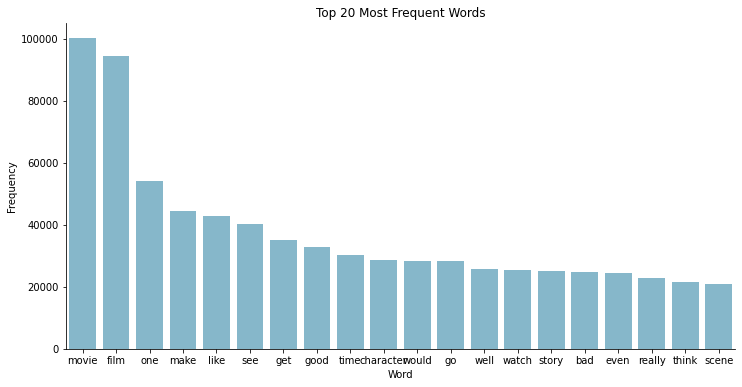

In [ ]:
#Converting word frequency into dataframes
frequency_df = pd.DataFrame.from_dict(all_word_freq, orient='index').reset_index()
# rename the columns to "word" and "freq"
frequency_df.columns=["word", "freq"]
#Plotting Graph for top 20 words
fig, ax = plt.subplots(figsize=(12,6))
sns.barplot(data=frequency_df.sort_values(by="freq", ascending=False).head(20), 
            y="freq", 
            x="word", 
            color='#7bbcd5')
plt.ylabel("Frequency")
plt.xlabel("Word")
plt.title("Top 20 Most Frequent Words")
sns.despine();

**4. Build a word cloud to determine the most important words**

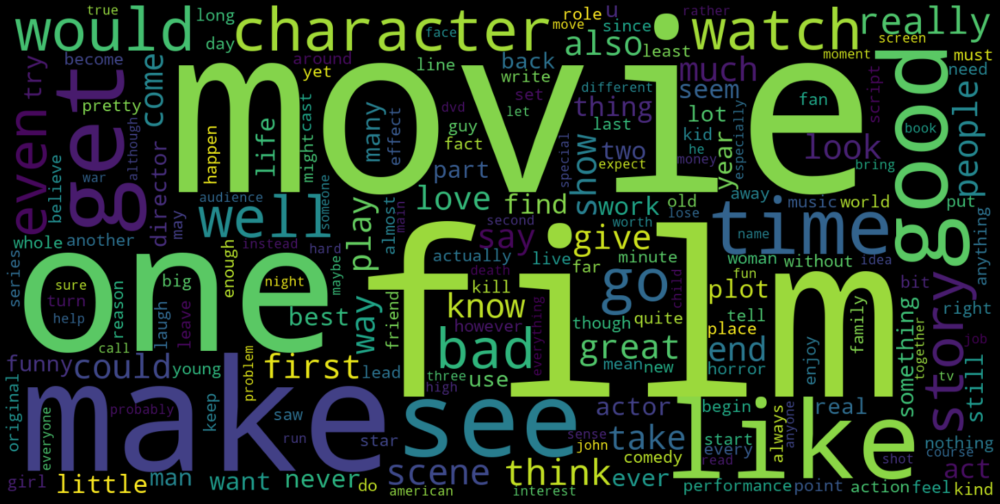

In [ ]:
# BUILD WORD CLOUD
wcloud = WordCloud(width=1600, height=800).generate_from_frequencies(all_word_freq)

#plotting the wordcloud
plt.figure( figsize=(20,10), facecolor='k')
plt.imshow(wcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()

<H5 align="left"><b><u>Part C: Feature engineering (10 points)</u></b></H5>

<p align="justify">After preprocessing, make use of any of the techniques indicated below to transform the text data into a compatible
format for text analysis, i.e., provide answer to one of the questions below.
<ol>
<li>Convert the text data to features using the Bag of Words (BOW) algorithm, specifically the tri-gram model</li>
<li>Convert the text data to a matrix of TF-IDF features utilizing appropriate arguments</li>
</ol></p>

**Convert the text data to a matrix of TF-IDF features utilizing appropriate arguments**

In [ ]:
tfidf = TfidfVectorizer(max_features=50)
vect = tfidf.fit_transform([' '.join(l) for l in reviews['lemmatized']])

In [ ]:
vect.toarray()

array([[0.1775919 , 0.        , 0.        , ..., 0.        , 0.        ,
        0.15177575],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.1561216 , 0.        , 0.        , ..., 0.        , 0.17306965,
        0.        ],
       ...,
       [0.        , 0.35473061, 0.31714855, ..., 0.        , 0.        ,
        0.36447952],
       [0.        , 0.        , 0.1299868 , ..., 0.11120242, 0.        ,
        0.        ],
       [0.        , 0.        , 0.24110001, ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
vect.toarray()[5]

array([0.        , 0.36451833, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.29014209, 0.21037674,
       0.        , 0.        , 0.        , 0.        , 0.27771691,
       0.2606    , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.198886  , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.35557638, 0.        , 0.        , 0.32601726,
       0.23801022, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.36326316, 0.        ,
       0.        , 0.        , 0.        , 0.36436258, 0.        ])

**Convert the text data to features using the Bag of Words (BOW) algorithm, specifically the tri-gram**

In [ ]:
DF = {}
for i in range(len(reviews)):
    tokens = reviews['lemmatized'][i]
    for w in tokens:
        try:
            DF[w].add(i)
        except:
            DF[w] = {i}

In [ ]:
for i in DF:
  DF[i] = len(DF[i])
DF

{'watch': 17505,
 'time': 19770,
 'chaser': 23,
 'obvious': 1952,
 'make': 25382,
 'bunch': 1505,
 'friend': 4677,
 'maybe': 3950,
 'sit': 2422,
 'around': 5994,
 'one': 28573,
 'day': 6002,
 'film': 29723,
 'school': 2429,
 'say': 13375,
 'hey': 784,
 'let': 4713,
 'u': 6868,
 'pool': 315,
 'money': 3780,
 'together': 3927,
 'really': 15044,
 'bad': 14623,
 'movie': 32291,
 'something': 8123,
 'like': 24266,
 'ever': 9444,
 'still': 8565,
 'end': 13310,
 'moviedull': 1,
 'story': 15708,
 'script': 5463,
 'lame': 1289,
 'act': 12660,
 'poor': 3213,
 'cinematography': 1730,
 'bottom': 747,
 'barrel': 162,
 'stock': 550,
 'music': 4476,
 'etc': 1869,
 'corner': 307,
 'cut': 2232,
 'except': 2087,
 'would': 17873,
 'prevent': 325,
 'release': 2942,
 'life': 9300,
 'saw': 5487,
 'year': 9466,
 'ago': 1870,
 'remember': 3044,
 'particularly': 1789,
 'nasty': 655,
 'believe': 5077,
 'base': 2951,
 'true': 3718,
 'incident': 341,
 'young': 6079,
 'man': 7530,
 'break': 2297,
 'nurse': 276,
 '

In [ ]:
#Printing Bag of Words
total_vocab = [x for x in DF]
print(total_vocab)

['watch', 'time', 'chaser', 'obvious', 'make', 'bunch', 'friend', 'maybe', 'sit', 'around', 'one', 'day', 'film', 'school', 'say', 'hey', 'let', 'u', 'pool', 'money', 'together', 'really', 'bad', 'movie', 'something', 'like', 'ever', 'still', 'end', 'moviedull', 'story', 'script', 'lame', 'act', 'poor', 'cinematography', 'bottom', 'barrel', 'stock', 'music', 'etc', 'corner', 'cut', 'except', 'would', 'prevent', 'release', 'life', 'saw', 'year', 'ago', 'remember', 'particularly', 'nasty', 'believe', 'base', 'true', 'incident', 'young', 'man', 'break', 'nurse', 'home', 'rape', 'torture', 'kill', 'various', 'woman', 'black', 'white', 'save', 'colour', 'shocking', 'shot', 'seem', 'try', 'political', 'statement', 'come', 'across', 'confused', 'obscene', 'avoid', 'minor', 'spoiler', 'new', 'york', 'joan', 'barnard', 'elvire', 'audrey', 'informed', 'husband', 'archeologist', 'arthur', 'john', 'saxon', 'mysteriously', 'murder', 'italy', 'search', 'etruscan', 'tomb', 'decide', 'travel', 'compan

In [ ]:
# Bag of N-Grams Model
bv = CountVectorizer(ngram_range=(3,3))
bv_matrix = bv.fit_transform(total_vocab)
bv_matrix = bv_matrix.toarray()
vocab = bv.get_feature_names()
pd.DataFrame(bv_matrix, columns=vocab)

,ad ad ad,ad ad brass,afoxdrinksblood livejournal com,alt fan bgcrisis,alt fan mikejittlov,amazon co uk,anarchist cookbook movie,and well they,anomalousmaterial blogspot com,aso gov autitlesfeaturesbuddies,ass jackass darin,ate eye cool,axenet berdvpresentation php,bartleby com html,bbc co ukhientertainmentmusic,bbc co ukhitalkingpoint,bbc co ukhitechnology,beautiful realistic interesting,bergtraum ny uscyberengshortslvta,blog myspace comlocoformovies,blogspot combeneath html,bogartdist atty martin,boy prophecy hero,cardboard err stone,celluloidtongue blogspot com,classiccinemaonline comindex please,co ukfilmpage html,co ukhientertainmentmusic stm,co ukhitalkingpoint stm,co ukhitechnology stm,cococravescinema blogspot com,comments imdb comcommentsauthorblakefrenchdlfspartanaol,cookbook movie avi,cool mummy ass,dangers perils plot,decade something anything,deiner proboards comindex,dogme dkthevowvow html,dr tart winship,dud dud dud,...,www myspace comwaywardtravler,www myths com,www nixflix com,www normsfilms com,www onceuponafamily com,www peakoil net,www phirherapheri inbase,www poffysmoviemania com,www popbunker net,www prisonplanet com,www reel org,www regentreleasing com,www residenthazard com,www rjmitchellspitfire co,www robertsreviews com,www rootsofyouthviolence on,www rtnville com,www sabbaththemovie com,www savingstarwars com,www scholarsfortruth org,www scifilm orgmusingsmusing,www simonsaysmovies blogspot,www skepticalanalysis com,www skipumps comdeepwell,www snopes com,www thebookofcaleb com,www thecinemaview blogspot,www thedunmore compoffymoviereviews,www thehollywoodnews com,www thepiratesrealm comcaptainkidd,www umbrellaent com,www youtube comprofileuserprevalentmind,www youtube comwatchvaksqelmgn,www youtube comwatchvmpfupnxs,www youtube comwatchvqkhmxbldu,www youtube comwatchvsecxwmxfbi,www youtube comwatchvyqhbgdoow,xxx bin laden,yadda yadda yadda,yet yes it
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152107,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
152108,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
152109,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
152110,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<H5 align="left"><b> Thank you </b></H5>
<H5 align="left"><b> Prepared and Submitted By : Rahul Raj Sharma </b></H5>